This is for using 4 channels, one brightfield and 3 fluorescent in the autoencoder.

### This is using compensated images
- Data directory: '/media/cjw/Data/cyto/mmFromTifs3/'
- Checkpoint directory;: "/media/cjw/Data/cyto/Checkpoints/2018-04-17-Chs-0-1-2-4_32_mmFromTifs3/checkpoint-2018-04-17-10-18-24/"
- Checkpoint file: 'autoencoder-256x-13980.meta'

In [1]:
import sys

In [2]:
sys.executable
sys.path.append('/Users/cjw/Projects/cjw/cyto/DeepLearning')

In [3]:
'''
Import the modules that will be used
'''

import sys
import warnings
from distutils.version import LooseVersion
import os

import numpy as np
import tensorflow as tf
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
#import hdbscan

import holoviews as hv
from autoencoder import network
from autoencoder import utils


import umap
%matplotlib inline
%pwd

'/Users/cjw/Projects/cjw/cyto/DeepLearning/autoencoder/ZebraFish2'

In [4]:
tf.__version__


'1.11.0'

In [5]:
datadir =  '/Users/cjw/Data/cyto/zf_unsorted/'
cp_dir = "/Users/cjw/Data/cyto/Checkpoints/2018-12-31-ZebraFish2_bf_ce/checkpoint-2018-12-31-20-19-21/"
aemeta = 'autoencoder-128x-30719.meta'
if os.path.exists(cp_dir + aemeta):
    print("OK")

OK


In [6]:
'''
Define the neural network that was used and define hyper-parameters.
These are needed to infer from the saved network checkpoint
'''

tf.reset_default_graph()
                  
print(cp_dir)

if os.path.exists(cp_dir):
    print("OK, exists")
else:
    print("Oh no")
#checkpoint-2018-03-02-16-31-42/'
p_width = 32
p_height = 32
p_nchannels = 1
p_channels = [0]
p_nepochs = 40
p_batchsize = 128
p_learning_rate = 0.0002  #.00005
p_restore = False
p_latent_size = 128
p_droprate = 0.75
p_stdev = .04

enc_sizes = [(128, 3), (256, 3), (512, 3)] 
dec_sizes = list(reversed(enc_sizes))

sess = tf.Session()
sess.run(tf.global_variables_initializer())
saver = tf.train.import_meta_graph(cp_dir + aemeta)
saver.restore(sess, cp_dir + aemeta.split('.')[0])


/Users/cjw/Data/cyto/Checkpoints/2018-12-31-ZebraFish2_bf_ce/checkpoint-2018-12-31-20-19-21/
OK, exists
INFO:tensorflow:Restoring parameters from /Users/cjw/Data/cyto/Checkpoints/2018-12-31-ZebraFish2_bf_ce/checkpoint-2018-12-31-20-19-21/autoencoder-128x-30719


In [7]:
images = sess.graph.get_tensor_by_name('Placeholder:0')
enc = sess.graph.get_tensor_by_name('latent_space/BiasAdd:0')
sdd = sess.graph.get_tensor_by_name('decoder_sigmoid:0')
dd = sess.graph.get_tensor_by_name('decoder_last:0')


In [8]:
mmfiles = utils.list_mmfiles(datadir)
print(mmfiles)

mmdict = dict()

n_all_images = 0
for mmfilename in mmfiles:

    mmheader = np.memmap(mmfilename, dtype="int32", mode='r',
                    shape=(4,))

    header_shape = mmheader.shape
    #print(header_shape, mmheader)
    xshape = [mmheader[0], mmheader[1], mmheader[2], mmheader[3]]
    xshape = tuple(xshape)
    del mmheader
    n_all_images += xshape[0]
    
    m3 = np.memmap(mmfilename, dtype='float32', offset=128,
              mode='r', shape=xshape)
    key = mmfilename.split("/")[-1]
    mmdict[key] = m3

mmdict.keys()

['/Users/cjw/Data/cyto/zf_unsorted/Unsorted_UnsortedFish2.mm', '/Users/cjw/Data/cyto/zf_unsorted/Unsorted_UnsortedFish6.mm', '/Users/cjw/Data/cyto/zf_unsorted/Unsorted_UnsortedFish7.mm', '/Users/cjw/Data/cyto/zf_unsorted/Unsorted_UnsortedFish3.mm', '/Users/cjw/Data/cyto/zf_unsorted/Unsorted_UnsortedFish8.mm', '/Users/cjw/Data/cyto/zf_unsorted/Unsorted_UnsortedFish4.mm', '/Users/cjw/Data/cyto/zf_unsorted/Unsorted_UnsortedFish1.mm', '/Users/cjw/Data/cyto/zf_unsorted/Unsorted_UnsortedFish5.mm']


dict_keys(['Unsorted_UnsortedFish2.mm', 'Unsorted_UnsortedFish6.mm', 'Unsorted_UnsortedFish7.mm', 'Unsorted_UnsortedFish3.mm', 'Unsorted_UnsortedFish8.mm', 'Unsorted_UnsortedFish4.mm', 'Unsorted_UnsortedFish1.mm', 'Unsorted_UnsortedFish5.mm'])

In [9]:
n = xshape[0]
all_ids =  range(n_all_images)
idx = 0
dataframes = list()
for key in mmdict.keys():
    mm = mmdict[key]
    n = mm.shape[0]
    #print(n)
    file = n*[key[0:-3].lower()]
    fid = range(n)
    mmfile = n*[key]
    plate = n*[0]
    row = n*[0]
    column = n*[0]
    field = n*[0]
    yc = n*[32]
    xc = n*[32]
    well = n*[0]
    ids = all_ids[idx:idx + n]
    idx += n
    xdf = pd.DataFrame({'id':ids, 'fid':fid, 'file':file, 'mmfile':mmfile, 'plate':plate,
                     'row':row, 'column':column, 'field':field,
                      'yc':yc, 'xc':xc, 'well':well})

    dataframes.append(xdf)
    
alldf = pd.concat(dataframes, ignore_index=True)
trts = list()
runs = list()

for row in range(len(alldf)):
    file = alldf.iloc[row]['file']
    if '_ice' in file.lower():
        treatment = 'ice'
    elif '_ccb'in file.lower():
        treatment = 'ccb'
    else:
        treatment = "untreated"
    trts.append(treatment)
    runs.append(file[0:5])

alldf['treatment'] = trts
alldf['run'] = runs

In [10]:

df = alldf.sample(frac=.2)
df = df.reset_index()
print(len(df))
df.tail()

14260


,index,id,fid,file,mmfile,plate,row,column,field,yc,xc,well,treatment,run
14255,15594,15594,6592,unsorted_unsortedfish6,Unsorted_UnsortedFish6.mm,0,0,0,0,32,32,0,untreated,unsor
14256,48530,48530,3832,unsorted_unsortedfish4,Unsorted_UnsortedFish4.mm,0,0,0,0,32,32,0,untreated,unsor
14257,20829,20829,2779,unsorted_unsortedfish7,Unsorted_UnsortedFish7.mm,0,0,0,0,32,32,0,untreated,unsor
14258,64538,64538,2225,unsorted_unsortedfish5,Unsorted_UnsortedFish5.mm,0,0,0,0,32,32,0,untreated,unsor
14259,21785,21785,3735,unsorted_unsortedfish7,Unsorted_UnsortedFish7.mm,0,0,0,0,32,32,0,untreated,unsor


In [11]:
sns.set_style("whitegrid", {'axes.grid' : False})
len(df)

14260

In [12]:
'''Read the images, display image, encode and show latent space, show decoded'''

batch = utils.getWell(mmdict,
                    df, p_width, 0, 0, p_nchannels, channels=p_channels)
bmean = batch.mean(axis=(1,2), keepdims=True)
bstd = batch.std(axis=(1,2), keepdims=True)
bmax = batch.max(axis=(1,2), keepdims=True)
bmin = batch.min(axis=(1,2), keepdims=True)
# print(bmin)
# print(bmax)
#vv = (batch - bmean)/bstd
vv = batch
nvv = len(vv)
offloc = 0
offstep = 1000
offnext = offloc + offstep
xhe = np.zeros((nvv, p_latent_size))
xdd = np.zeros((nvv, p_width, p_height, p_nchannels))
while offloc < nvv:
    #print(offloc, offnext)
    xhe[offloc:offnext] = sess.run(enc, feed_dict={images:vv[offloc:offnext]})
    xdd[offloc:offnext] = sess.run(sdd, feed_dict={enc:xhe[offloc:offnext]})
    offloc = offnext
    offnext += offstep
    if offnext > nvv:
        offnext = nvv
        


(0.0, 1.0, 0.16683301443654613)

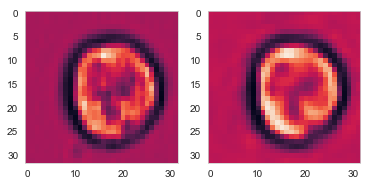

In [13]:
n =2012

plt.subplot(1,2,1)
plt.imshow(vv[n, :,:, 0])
plt.subplot(1,2,2)
plt.imshow(xdd[n, :,:, 0])
vv[:,:,:,0].min(), vv[:,:,:,0].max(), vv[:,:,:,0].std()

In [14]:
metric = 'correlation'

In [15]:
embedding = umap.UMAP(n_neighbors=16, min_dist=0.0000001,
                      n_components=16,
                      metric=metric).fit_transform(xhe)



In [16]:
vis = umap.UMAP(n_neighbors=16, min_dist=.0,
                      n_components=2,
                      metric=metric).fit_transform(xhe)

df['x'] = vis[:,0]
df['y'] = vis[:,1]

In [17]:
nclust = 10
from sklearn import cluster, mixture
from sklearn.mixture import GaussianMixture, BayesianGaussianMixture

km = cluster.KMeans(n_clusters=nclust).fit_predict(xhe)
agc = cluster.AgglomerativeClustering(n_clusters=nclust, affinity='euclidean', linkage="ward").fit_predict(xhe)

df['agc'] =agc
df['km'] = km


In [18]:
import autoencoder.hover as hover
from bokeh.plotting import figure, ColumnDataSource
from bokeh.models import HoverTool, ZoomInTool, ZoomOutTool
from bokeh.io import output_notebook, show
from bokeh.palettes import Spectral6, inferno

fimages = np.zeros((vv.shape[0], 32, 32*1), np.float32)
fimages[:,:,0:32] = 255*((vv[:,:,:,0] - vv[:,:,:,0].min())/(vv[:,:,:,0].max() - vv[:,:,:,0].min()))

bimages = fimages.astype(np.int32)
urls = hover.encode_images(bimages)

#### Here is the code for the html tool tip

```html
<div>
  <div>
    <img
      src="@image_urls" height="64"
      style="float: left; margin: 0px 15px 15px 0px; image-rendering: pixelated;"
      border="2"
      ></img>
  </div>
  <div>
    <span style="font-size: 17px;">@source_text</span>
  </div>
</div>
```

In [23]:


uc ='agc'
colors = pd.Series(inferno((df[uc].max() - df[uc].min()) + 1))
dmin = df[uc].min()
dnum = df[uc].max() - df[uc].min() + 1

colormap = {cid: colors[cid - dmin] for cid in df[uc] }

output_notebook()

df['colors'] = df[uc].map(colormap)
# fimages = 255*vv[:,:,:,0]


df['source_text']=df[uc]
df['image_urls'] = urls

hv = HoverTool(tooltips=hover.maketooltip())

src = ColumnDataSource(data=df)
TOOLS = [ZoomInTool(), ZoomOutTool(), hv]
p = figure(plot_width=800, plot_height=800,
           title="Hey, that's nice", tools=TOOLS)

p.circle('x','y', size=6, source=src, color='colors')

show(p)


Loading BokehJS ...

In [60]:
from sklearn.manifold import TSNE

tsne = TSNE(perplexity=30, learning_rate=200, metric='correlation').fit_transform(xhe)

df['tx'] = tsne[:,0]
df['ty'] = tsne[:,1]


In [61]:

hv = HoverTool(tooltips=hover.maketooltip())

src = ColumnDataSource(data=df)
TOOLS = [ZoomInTool(), ZoomOutTool(), hv]
p = figure(plot_width=800, plot_height=800,
           title="Hey, that's nice", tools=TOOLS)

p.circle('tx','ty', size=6, source=src, color='colors')

show(p)

-------------------------------------------------------------------------